----

### <span style="color:#0b486b">SIT744 Practical Machine Learning for Data Science</span>


---


# <span style="color:#0b486b">Assignment Two: Deep Neural Networks, Representation Learning, and Text Analytics</span>
### Due: <span style="color:red">24:00pm 24 September 2019</span>  (Tuesday)

#### <span style="color:red">Important note:</span> This is an **individual** assignment. It contributes **40%** to your final mark. Read the assignment instruction carefully.

This notebook has been prepared for your to complete Assignment 2. The theme of this assignment is about practical machine learning knowledge and skills in deep neural networks, word embedding and text analytics. Some sections have been partially completed to help you get
started. **The total marks for this notebook are 80 marks, which will be re-scaled to 40 marks in the grade.**.

* Before you start, read the entire notebook carefully once to understand what you need to do. <br><br>

* For each cell marked with **#YOU ARE REQUIRED TO INSERT YOUR CODES IN THIS CELL**, there will be places where you **must** supply your own codes when instructed. <br>

## <span style="color:#0b486b">Instruction</span>

This assignment contains **two** parts 

* Part 1: Deep Feedforward Neural Network **[45 points]**
* Part 2: Word2Vec, text analytics and application **[35 points]**

**Hint**: This assignment was essentially designed based on the lectures and practical lab sessions covered from Week 5 to 9. You are strongly recommended to go through these contents thoroughly which might help you to complete this assignment.

## <span style="color:#0b486b">What to submit</span>

This assignment is to be completed individually and submitted to CloudDeakin. **By the due date, you are required to submit the following files to the corresponding Assignment in CloudDeakin**:

1.	<span style="color:red">**[YourID]_assignment2_solution.ipynp**</span>:  **this is your Python notebook solution source file**.
1.	<span style="color:red">**[YourID]_assingment2_output.html**</span>: **this is the output of your Python notebook solution *exported* in html format**.
1.	<span style="color:red">Any extra files needed to complete your assignment</span> (e.g., images used in your answers).

For example, if your student ID is: 123456, you will then need to submit the following files:
* 123456_assignment2_solution.ipynp
* 123456_assignment2_output.html
* any extra files or subfolder you might have (this can be named according to your preference).

<span style="color:red">Please proceed to the content below to complete your assignment!</span>

## <span style="color:#0b486b">Part 1: Deep Feedforward Neural Network </span>
<div style="text-align: right"><span style="color:red">**[Total mark for this part: 45 points]**<span></div>

The first part of this assignment is for you to demonstrate the knowledge in deep learning that you have acquired from the lectures and practical lab materials. Most of the contents in this assignment are drawn from the practical materials in week 5, 6 and 7 for deep neural networks. Going through these materials before attempting this assignment is highly recommended.

*Run the following cell to create necessary subfolders for this assignment. You must **not** modify these codes and **must** run it first*.

In [1]:
# Create necessary subfolders to store immediate files for this assignment.

import os
if not os.path.exists("./models/dnn0"):
    os.makedirs("models/dnn0")

The first part of this assignment is to apply DNN to recognize letters from A-Z. You have played with MNIST dataset in your pracs and this should have given a good sense of how to apply DNN on images for recognition task. 

In this assignment, you are going to work with the **notMNIST** dataset for *letter recognition task*. The dataset contains 10 classes of letters A-J taken from different fonts. You will see some examples at the visualization task in the next part. A short blog about the data can be found [here](http://yaroslavvb.blogspot.com.au/2011/09/notmnist-dataset.html).

Here we only consider a small subset which can be found at [this link](http://yaroslavvb.com/upload/notMNIST/notMNIST_small.mat). This file has been already downloaded and stored in subfolder `datasets` of this assignment folder. The file is in *Matlab* format, thus our first task is to:

####  <span style="color:red">**Question 1.1**</span>. Load the data into *`numpy array`* format of two variables:
* *`x`*: storing features with dimension `[num_samples, width, height]` (`num_samples`: number of samples, `width`: image width, `height`: image height), and
* *`y`*: storing labels with dimension `num_samples`. 
<div style="text-align: right"><span style="color:red">**[3 points]**</span></div>

Enter the missing codes in the following cell to complete this question.

In [4]:
# YOU ARE REQUIRED TO INSERT YOUR CODES IN THIS CELL

import numpy as np
import scipy.io as sio
data = sio.matlab.loadmat("datasets/notMNIST_small.mat")
print(data.keys())
x, y = np.array(data['images']), np.array(data['labels'])# INSERT YOUR CODE HERE
x = np.rollaxis(x, axis=2)

dict_keys(['__header__', '__version__', '__globals__', 'images', 'labels'])


####  <span style="color:red">**Question 1.2**</span>. Print out the total number of data points, and the *unique* labels in this dataset.
<div style="text-align: right"><span style="color:red">**[3 points]**</span></div> 

In [3]:
#YOU ARE REQUIRED TO INSERT YOUR CODES IN THIS CELL
TotalLength = len(x)
Totalunique=(np.unique(y))
print("The total number of data points are "+ str(TotalLength)+" and the "+f"Number of Unique labels:{np.unique(y)}"+".")

The total number of data points are 18724 and the Number of Unique labels:[0. 1. 2. 3. 4. 5. 6. 7. 8. 9.].


####  <span style="color:red">**Question 1.3**</span>. Display 100  images in the form of `10x10` matrix, each row showing 10 *random* images of a label. You might decide to use the function `display_images` provided at the beginning of this assignment, or you can write your own codes.
<div style="text-align: right"><span style="color:red">**[4 points]**</span></div> 

In [4]:
# this function is a utility to display images from the dataset
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

def display_images(images, shape):
    fig = plt.figure(figsize=shape)
    fig.subplots_adjust(left=0, right=1, bottom=0, top=1, hspace=0.05, wspace=0.05)
    for i in range(np.prod(shape)):
        p = fig.add_subplot(shape[0], shape[1], i+1, xticks=[], yticks=[])
        p.imshow(images[i], cmap=plt.cm.bone)                

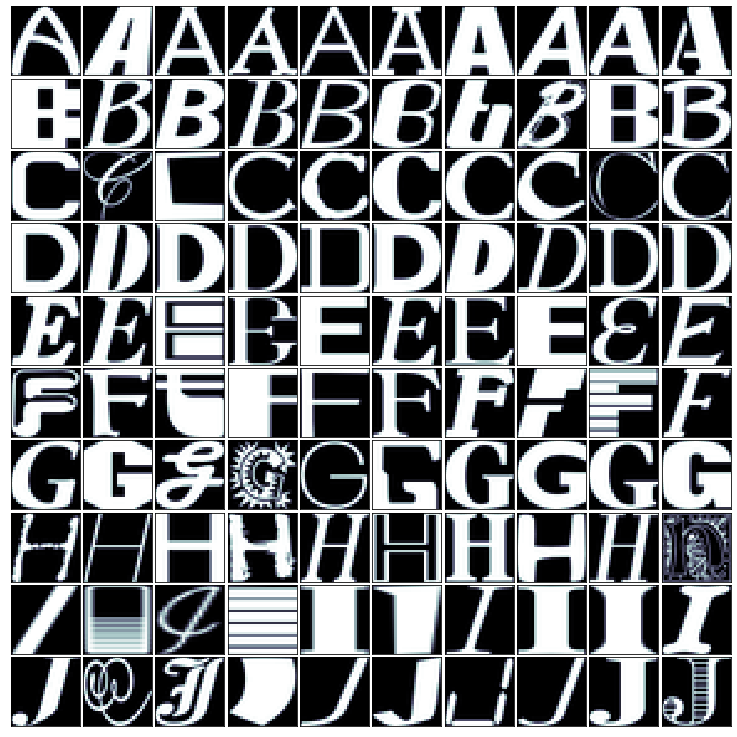

In [5]:
# YOU ARE REQUIRED TO INSERT YOUR CODES IN THIS CELL

unique_labels = np.unique(y)# INSERT YOUR CODE HERE
images = []
for l in unique_labels:    
    idx = np.where(y == l)[0]
    idx = idx[np.random.permutation(len(idx))[:10]]    
    for i in idx:
        images.append(x[i]) # INSERT YOUR CODE HERE

display_images(images, shape=(10, 10))

####  <span style="color:red">**Question 1.4**</span>. Use the *deep feedforward neural network* as the classifier to perform images classification task in a *single split training and testing*.

The total marks for this question is <span style="color:red">**[35 points]**</span>, with the following detailed breakdown sub-questions:

<span style="color:red">**(a)**</span> **Write your code to reshape the variable `x` storing features from `[num_samples, width, height]` dimension to `[num_samples, num_features]` with `num_features = width x height`. ** (*Hint*: you might want to use the `reshape()' function)
<div style="text-align: right"> <span style="color:red">**[3 points]**</span> </div>

In [6]:
# YOU ARE REQUIRED TO INSERT YOUR CODES IN THIS CELL

img,h,w = np.shape(x)#Getting total number of values, height and width of X(Inputs) 
z = np.array(x)
num_features = w * h # w and h are the width and height odtained from data['images'](or the input)

z = z.reshape(len(x),num_features)
print(z)

[[  0.   0.   0. ...   0.   0.   0.]
 [  0.   1.   0. ... 175.  75.   0.]
 [  0.   0.   0. ...   0.   0.   0.]
 ...
 [  0.   0.   0. ...   0.   0.   0.]
 [  0.   0.   0. ...   0.   0.   0.]
 [  0.   0.   0. ...  63.  22.   1.]]


In training the DNN, scaling data is important. The pixel intensities of images are in the range of [0, 255], which makes the neural network difficult to learn.

**Rescale the input data into the range of [0, 1]**
<div style="text-align: right"> 
<span style="color:red">**[2 points]**</span> </div>

In [7]:
# YOU ARE REQUIRED TO INSERT YOUR CODES IN THIS CELL
from sklearn import preprocessing

min_max_scaler = preprocessing.MinMaxScaler()#using min max scaler to rescale the inputs
reimage = min_max_scaler.fit_transform(z)

print(reimage.shape)
print(reimage.min()) #to get the min value
print(reimage.max()) #to get max value


(18724, 784)
0.0
1.0


<span style="color:red">**(b)**</span> **Split the data into two subsets: 70% for training and 30% for testing. Note that you must use [*Stratified-Shuffle-Split*](http://scikit-learn.org/stable/modules/generated/sklearn.model_selection.StratifiedShuffleSplit.html) to make sure training and testing are balanced and randomly shuffled before learning the model.**
<div style="text-align: right"> <span style="color:red">**[5 points]**</span> </div>

In [8]:
# YOU ARE REQUIRED TO INSERT YOUR CODES IN THIS CELL
from sklearn.model_selection import StratifiedShuffleSplit
sss = StratifiedShuffleSplit(n_splits=1, test_size=0.3, random_state=0)
sss.get_n_splits(reimage, y)
for train_index, test_index in sss.split(reimage, y):
    print("TRAIN:", train_index, "TEST:", test_index)
    X_train, X_test = reimage[train_index], reimage[test_index]
    y_train, y_test = y[train_index], y[test_index]


TRAIN: [ 4192   411  2934 ...  7122 15145 16625] TEST: [11500  7565 16561 ...  2033  6050 11972]


<span style="color:red">**(c)**</span> **Construct a deep feedforward neural network with the following architecture:**

* An input layer followed by *two* hidden layers, each with *500* hidden units, and an *output* layer;
* *ReLU* activations for neurons in each hidden layer;
* Training with gradient descent optimizer with learning rate **0.0011**, batch size 128 and 50 epochs.

(*Hint*: *this question heavily relies on the knowledge you've learned from lab session in week 5 and 6. You are encouraged to revise these materials for this question*)

<div style="text-align: right"> <span style="color:red">**[20 points]**</span> </div>

In [9]:
# YOU ARE REQUIRED TO INSERT YOUR CODES IN THIS CELL [5 marks]

import tensorflow as tf

tf.reset_default_graph()

num_inputs = 28*28# INSERT YOUR CODE HERE
num_hidden1 = 500 # INSERT YOUR CODE HERE
num_hidden2 = 500# INSERT YOUR CODE HERE
num_outputs = len(np.unique(y))
learning_rate = 0.0011

inputs = tf.placeholder(tf.float32, shape=[None, num_inputs], name="inputs")# INSERT YOUR CODE HERE
labels = tf.placeholder(tf.int32, shape=[None], name="labels")# INSERT YOUR CODE HERE

C:\Users\Ashutosh\Anaconda3\lib\site-packages\tensorflow\python\framework\dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
C:\Users\Ashutosh\Anaconda3\lib\site-packages\tensorflow\python\framework\dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
C:\Users\Ashutosh\Anaconda3\lib\site-packages\tensorflow\python\framework\dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
C:\Users\Ashutosh\Anaconda3\lib\site-packages\tensorflow\python\framework\dtypes.py:519: FutureWa

In [10]:
def neuron_layer(x, num_neurons, name, activation=None):
    with tf.name_scope(name):
        # INSERT YOUR CODE HERE
        num_inputs = int(inputs.get_shape()[1])
        stddev = 2 / np.sqrt(num_inputs)
        init = tf.truncated_normal([num_inputs, num_neurons], stddev=stddev)
        W = tf.Variable(init, name="weights")
        b = tf.Variable(tf.zeros([num_neurons]), name="biases")
        z = tf.matmul(inputs, W) + b
    if activation == "sigmoid":
        # INSERT YOUR CODE HERE
        return tf.nn.sigmoid(z)
    elif activation == "relu":
        # INSERT YOUR CODE HERE
        return tf.nn.relu(z)
    else:
        return z

In [11]:
with tf.name_scope("dnn"):
    hidden1 = neuron_layer(inputs, num_hidden1, "hidden1", activation="sigmoid")# INSERT YOUR CODE HERE
    hidden2 = neuron_layer(hidden1, num_hidden2, "hidden2", activation="sigmoid")# INSERT YOUR CODE HERE
    logits = neuron_layer(hidden2, num_outputs, "output")# INSERT YOUR CODE HERE
with tf.name_scope("loss"):
    xentropy = tf.nn.sparse_softmax_cross_entropy_with_logits(labels=labels, logits=logits)# INSERT YOUR CODE HERE
    loss = tf.reduce_mean(xentropy, name="loss")
with tf.name_scope("evaluation"):
    xentropy = tf.nn.sparse_softmax_cross_entropy_with_logits(labels=labels,\
                                        logits=logits, name='xentropy')
    correct = tf.nn.in_top_k(logits, labels, 1)
    accuracy = tf.reduce_mean(tf.cast(correct, tf.float32),name="accuracy")
with tf.name_scope("train"):
    learning_rate = 0.0011
    optimizer = tf.train.GradientDescentOptimizer(learning_rate)
    grads = optimizer.compute_gradients(loss)
    training_op = optimizer.apply_gradients(grads)
init= tf.global_variables_initializer()
saver = tf.train.Saver()
for var in tf.trainable_variables():
    tf.summary.histogram(var.op.name + "/values", var)
        
for grad, var in grads:
    if grad is not None:
        tf.summary.histogram(var.op.name + "/gradients", grad)

# summary
accuracy_summary = tf.summary.scalar('accuracy', accuracy)# INSERT YOUR CODE HERE
print(accuracy_summary)

Tensor("accuracy:0", shape=(), dtype=string)


In [12]:
# YOU ARE REQUIRED TO INSERT YOUR CODES IN THIS CELL [5 marks]

# merge all summary
tf.summary.histogram('hidden1/activations', hidden1)
tf.summary.histogram('hidden2/activations', hidden2)
merged = tf.summary.merge_all()# INSERT YOUR CODE HERE

init = tf.global_variables_initializer()# INSERT YOUR CODE HERE
saver = tf.train.Saver()# INSERT YOUR CODE HERE

train_writer = tf.summary.FileWriter("models/dnn0/train", tf.get_default_graph())
test_writer = tf.summary.FileWriter("models/dnn0/test", tf.get_default_graph())

num_epochs = 50# INSERT YOUR CODE HERE
batch_size = 128# INSERT YOUR CODE HERE


<span style="color:red">**(d)**</span> **You are now required write code to train the DNN.** Write codes in the following cell. <span style="color:red">**[5 points]**</span> </div>

In [13]:
# YOU ARE REQUIRED TO INSERT YOUR CODES IN THIS CELL


with tf.Session() as sess:
    init.run()
    print("Epoch\tTrain accuracy\tTest accuracy")
    for epoch in range(num_epochs):
        for idx_start in range(0, X_train.shape[0], batch_size):
            idx_end = idx_start + batch_size
            x_batch, y_batch = X_train[idx_start:idx_end],y_train[idx_start:idx_end] 

            sess.run(training_op, feed_dict={inputs: x_batch, labels: y_batch})
            
        summary_train, acc_train = sess.run([merged, accuracy],feed_dict={inputs: x_batch, labels: y_batch})
        summary_test, acc_test = sess.run([accuracy_summary, accuracy],feed_dict={inputs: X_test, labels: y_test})
        
        train_writer.add_summary(summary_train, epoch)
        test_writer.add_summary(summary_test, epoch)
        
        print("{}\t{}\t{}".format(epoch, acc_train, acc_test))

    save_path = saver.save(sess, "models/dnn0/dnn_final.ckpt")
    
train_writer.close()
test_writer.close()

Epoch	Train accuracy	Test accuracy
0	0.20000000298023224	0.2232111096382141
1	0.3799999952316284	0.3526165783405304
2	0.46000000834465027	0.4668921232223511
3	0.5799999833106995	0.5628337264060974
4	0.6800000071525574	0.6290494799613953
5	0.7400000095367432	0.6707013249397278
6	0.7799999713897705	0.7038092017173767
7	0.7799999713897705	0.7232111096382141
8	0.800000011920929	0.7413670420646667
9	0.8199999928474426	0.7538269758224487
10	0.8199999928474426	0.7668209075927734
11	0.8199999928474426	0.7766109108924866
12	0.8199999928474426	0.783552885055542
13	0.8399999737739563	0.7881808280944824
14	0.8399999737739563	0.793164849281311
15	0.8399999737739563	0.7985048294067383
16	0.8600000143051147	0.8013527989387512
17	0.8600000143051147	0.804912805557251
18	0.8600000143051147	0.8082947731018066
19	0.8600000143051147	0.811498761177063
20	0.8600000143051147	0.8134567737579346
21	0.8600000143051147	0.8168387413024902
22	0.8600000143051147	0.8191527128219604
23	0.8600000143051147	0.82235670089

---

## <span style="color:#0b486b">Part 2: Word2Vec, Text Analytics and Application</span>
<div style="text-align: right"><span style="color:red">**[Total mark for this part: 35 points]**<span></div>


In this part, you are going to use Word2Vec for document classification on [20 Newsgroups](http://www.cs.cmu.edu/afs/cs.cmu.edu/project/theo-20/www/data/news20.html) dataset. This dataset is a collection of messages collected from 20 different netnews newsgroups. One thousand messages from each of the twenty newsgroups were chosen at random and partitioned by newsgroup name. The list of newsgroups from which the messages were chosen is as follows:

`
alt.atheism
talk.politics.guns
talk.politics.mideast
talk.politics.misc
talk.religion.misc
soc.religion.christian
comp.sys.ibm.pc.hardware
comp.graphics
comp.os.ms-windows.misc
comp.sys.mac.hardware
comp.windows.x
rec.autos
rec.motorcycles
rec.sport.baseball
rec.sport.hockey
sci.crypt
sci.electronics
sci.space
sci.med
misc.forsale
`

### <span style="color:#0b486b"> Download the dataset and data pre-processing</span>

####  <span style="color:red">**Question 2.1**</span> Your first task is to run the following code to download the dataset.

<div style="text-align: right"><span style="color:red">**[1 point]**</span></div> 

In [4]:
from sklearn.datasets import fetch_20newsgroups
import numpy as np
newsgroups_all = fetch_20newsgroups(subset='all', remove=('headers'))
newsgroups_all
Refinedtext = (str(newsgroups_all).replace('\\n',''))
Refinedtext = (Refinedtext.replace('\\t',''))
Refinedtext.strip('\\')

'{\'data\': ["I am sure some bashers of Pens fans are pretty confused about the lackof any kind of posts about the recent Pens massacre of the Devils. Actually,I am  bit puzzled too and a bit relieved. However, I am going to put an endto non-PIttsburghers\' relief with a bit of praise for the Pens. Man, theyare killing those Devils worse than I thought. Jagr just showed you whyhe is much better than his regular season stats. He is also a lotfo fun to watch in the playoffs. Bowman should let JAgr have a lot offun in the next couple of games since the Pens are going to beat the pulp out of Jersey anyway. I was very disappointed not to see the Islanders lose the finalregular season game.          PENS RULE!!!", \'  My brother is in the market for a high-performance video card that supportsVESA local bus with 1-2MB RAM.  Does anyone have suggestions/ideas on:  - Diamond Stealth Pro Local Bus  - Orchid Farenheit 1280  - ATI Graphics Ultra Pro  - Any other high-performance VLB cardPlease pos

In [5]:
# import modules & set up logging
import gensim, logging
 
sentences = [['first', 'sentence'], ['second', 'sentence']]
# train word2vec on the two sentences
model = gensim.models.Word2Vec(sentences, min_count=1)
print(model.wv['first'])

[ 5.7877996e-04  7.8634534e-04  1.8936904e-03 -4.0534423e-03
  3.9473935e-03 -3.0969616e-04 -4.6086344e-03  3.9351550e-03
  2.6250789e-03  3.4443638e-03  3.5654719e-03  2.5940398e-03
  3.1747676e-03 -3.6026028e-03  1.1013819e-04  2.7227635e-03
 -1.1315426e-03 -1.7193534e-03  4.6009006e-04 -3.4375640e-03
 -3.5420367e-03 -4.9937405e-03  2.2216848e-04  4.7143050e-03
 -3.8715287e-05  1.5664530e-03 -3.7312477e-03  3.0620149e-03
  4.6907687e-03 -2.3580031e-03 -1.8818837e-03  1.8731665e-03
 -4.6790307e-03  6.5206579e-04  1.0819942e-03  4.2876578e-03
 -4.0688775e-03  9.1329840e-04 -1.1036111e-03 -2.4045573e-03
  3.3223170e-03 -1.6540322e-03  2.0026334e-03 -5.0456740e-04
 -1.3434357e-03 -3.9606672e-03  7.4832357e-04 -5.1992323e-04
 -9.7660779e-04 -9.3046852e-05 -4.0668622e-03 -5.3826207e-04
  2.4265095e-03 -1.2618342e-03  4.4937273e-03 -4.2285076e-03
 -3.7294920e-03 -1.0062285e-03  3.7026841e-03 -7.4663357e-04
  2.6877248e-03  2.7313670e-03 -2.4841460e-03  1.6552157e-03
 -3.4204575e-03  3.29118

####  <span style="color:red">**Question 2.2**</span>. Print out the total number of documents, and the *unique* labels in this dataset.
<div style="text-align: right"><span style="color:red">**[1 point]**</span></div> 

In [6]:
# YOU ARE REQUIRED TO INSERT YOUR CODES IN THIS CELL
#print("There are "+str(len(newsgroups_all))+" documents in total in this dataset.")
print(f"Total number of document present in above dataset :{len(newsgroups_all['filenames'])}") # Total number of document present in above dataset
print(f"And Total number of labels present in array: {len(newsgroups_all['target_names'])}")
print(np.unique(newsgroups_all['target_names'])) # And data present in the dataset named as target_names

Total number of document present in above dataset :18846
And Total number of labels present in array: 20
['alt.atheism' 'comp.graphics' 'comp.os.ms-windows.misc'
 'comp.sys.ibm.pc.hardware' 'comp.sys.mac.hardware' 'comp.windows.x'
 'misc.forsale' 'rec.autos' 'rec.motorcycles' 'rec.sport.baseball'
 'rec.sport.hockey' 'sci.crypt' 'sci.electronics' 'sci.med' 'sci.space'
 'soc.religion.christian' 'talk.politics.guns' 'talk.politics.mideast'
 'talk.politics.misc' 'talk.religion.misc']


####  <span style="color:red">**Question 2.3**</span>. Convert the documents into a list of tokens using the function `gensim.utils.tokenize`.
<div style="text-align: right"><span style="color:red">**[3 point]**</span></div>


In [7]:
#from gensim.utils import tokenize
#tokens = list(tokenize(Refinedtext, deacc = True))

# YOU ARE REQUIRED TO INSERT YOUR CODES IN THIS CELL

import gensim
from gensim.utils import tokenize

token = []

for index in range(len(newsgroups_all.data)):
    t_list = tokenize(newsgroups_all.data[index])
    token.append(list(t_list))
token

[['I',
  'am',
  'sure',
  'some',
  'bashers',
  'of',
  'Pens',
  'fans',
  'are',
  'pretty',
  'confused',
  'about',
  'the',
  'lack',
  'of',
  'any',
  'kind',
  'of',
  'posts',
  'about',
  'the',
  'recent',
  'Pens',
  'massacre',
  'of',
  'the',
  'Devils',
  'Actually',
  'I',
  'am',
  'bit',
  'puzzled',
  'too',
  'and',
  'a',
  'bit',
  'relieved',
  'However',
  'I',
  'am',
  'going',
  'to',
  'put',
  'an',
  'end',
  'to',
  'non',
  'PIttsburghers',
  'relief',
  'with',
  'a',
  'bit',
  'of',
  'praise',
  'for',
  'the',
  'Pens',
  'Man',
  'they',
  'are',
  'killing',
  'those',
  'Devils',
  'worse',
  'than',
  'I',
  'thought',
  'Jagr',
  'just',
  'showed',
  'you',
  'why',
  'he',
  'is',
  'much',
  'better',
  'than',
  'his',
  'regular',
  'season',
  'stats',
  'He',
  'is',
  'also',
  'a',
  'lot',
  'fo',
  'fun',
  'to',
  'watch',
  'in',
  'the',
  'playoffs',
  'Bowman',
  'should',
  'let',
  'JAgr',
  'have',
  'a',
  'lot',
  'of',


### <span style="color:#0b486b"> Train the model </span>


####  <span style="color:red">**Question 2.4**</span>. Train gensim's word2vec model.
<div style="text-align: right"><span style="color:red">**[5 points]**</span></div>

* Train gensim's word2vec model with the settings of:
    * The dimensionality of the feature vectors: `size=100`,
    * The maximum distance between the current and predicted word within a sentence: `window=5`,
    * Minimum frequence (ignore all words with total frequency lower than this): `min_count=5`,


In [14]:
from gensim.models import Word2Vec
sg_ = 1 # the training algorithm. If sg=0, CBOW is used. Otherwise (sg=1), skip-gram is employed.
alg = 'CBOW' if sg_ == 0 else 'sg'
size_ = 100 #  the dimensionality of the feature vectors
window_ = 5 # the context size or the maximum distance between the current and predicted word

# where to save the model learned
#a20_newsgroupsgensim = 'C:/Users/Ashutosh/OneDrive - Deakin University/Prac Machine Learning/Assign 2/model' + alg + '_' + str(size_) + '_' + str(window_)

model = Word2Vec(token, size_, window_, min_count=5, workers=8)
words = list(model.wv.vocab.keys())
print(f"The first 10 words in the vocabularies: {words[0:10]}")

The first 10 words in the vocabularies: ['I', 'am', 'sure', 'some', 'bashers', 'of', 'Pens', 'fans', 'are', 'pretty']


* Save the trained model to a file named "20_newsgroups.gensim"

In [16]:
# YOU ARE REQUIRED TO INSERT YOUR CODES IN THIS CELL
# save the model learned into model file
model_file = 'model/wiki/20_newsgroups.gensim'
model.save(model_file)

####  <span style="color:red">**Question 2.5**</span>. Print out the vocabulary size (number of words in vocabulary).
<div style="text-align: right"><span style="color:red">**[2 points]**</span></div> 

In [17]:
# YOU ARE REQUIRED TO INSERT YOUR CODES IN THIS CELL
#since our variable words has the entire content of words and vocabs printing out simple len of it gives the size
words = list(model.wv.vocab.keys())
print(f"The number of words in vocabulary are: {len(words)}")

The number of words in vocabulary are: 42461


####  <span style="color:red">**Question 2.6**</span>. Using the embedding results, calculate and print out the ten most similar words to word 'law' and their corresponding similarity scores.<div style="text-align: right"><span style="color:red">**[3 points]**</span></div> 

In [18]:
# YOU ARE REQUIRED TO INSERT YOUR CODES IN THIS CELL
model.wv.most_similar(positive='law')
#model['law']
#model.wv.most_similar('law')

[('unwise', 0.9716055989265442),
 ('minister', 0.9674339294433594),
 ('Mohammad', 0.9674338102340698),
 ('AL', 0.9654719233512878),
 ('Khocaly', 0.9610120058059692),
 ('grim', 0.9610118865966797),
 ('HM', 0.9568259716033936),
 ('Dynasty', 0.9564173817634583),
 ('Arctic', 0.9564166069030762),
 ('dozen', 0.9552630186080933)]

### <span style="color:#0b486b"> Evaluate the embeddings using classification </span>

Now we investigate the quality of embedded vectors via document classification task. We have learned the embeddings for words, but not for documents yet, thus we need to find a way to extract the document embeddings from word embeddings. We are going to try two approaches:
* Taking the **sum** of vectors of all words in the document; or
* Taking the **average** of vectors of all words in the document.

####  <span style="color:red">**Question 2.7**</span>. Extract document vectors using `sum`.
<div style="text-align: right"><span style="color:red">**[5 points]**</span></div> 

* Remove all ***empty*** documents. A document is empty if it does not contain any word in the vocabulary;
* Extract document vectors and save to variable `x`;
* Save the corresponding labels to variable `y`.

In [21]:
def remove_doc(docs,labls):#function for removing all empty documents
    
    for i in range(len(newsgroups_all.filenames)):
        
        do = []#Initializing empty array to store documents
        labl = []#Initializing empty array to store labels
        for doc, label in zip(docs,labls):
            if doc.strip():
                do.append(doc)
                labl.append(label)
    return do, labl

empty_doc , empty_label = remove_doc(newsgroups_all.data,newsgroups_all.target)#removing empty documents and extracting it to variables empty_doc and empty_label 



In [22]:
#getting or extracting document vectors
import numpy as np
from sklearn.metrics import accuracy_score

def extract_doc2vec(doc, w2v):
    vecs = [w2v[word] for word in doc if word in w2v]
    if len(vecs) > 0:
        vecs = np.asarray(vecs).sum(axis=0)
        return vecs

emp_x = [] #Taking an empty array emp_x for document vectors
#
for d in empty_doc:
    emp_x.append(extract_doc2vec(d,model))
    
#Saving the correspondong variables to x and y    
x = emp_x
y = empty_label

C:\Users\Ashutosh\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DeprecationWarning: Call to deprecated `__contains__` (Method will be removed in 4.0.0, use self.wv.__contains__() instead).
  """
C:\Users\Ashutosh\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  """


####  <span style="color:red">**Question 2.8**</span>. Print out the number of documents retained after removing empty documents.
<div style="text-align: right"><span style="color:red">**[1 point]**</span></div> 

In [23]:
# YOU ARE REQUIRED TO INSERT YOUR CODES IN THIS CELL
print(f"The number of documents retained after removing emplty documents are:{len(x)}")


The number of documents retained after removing emplty documents are:18812


#### <span style="color:red">**Question 2.9**</span>. Split the data into two subsets: 70% for training and 30% for testing. Note that you must use [*Stratified-Shuffle-Split*](http://scikit-learn.org/stable/modules/generated/sklearn.model_selection.StratifiedShuffleSplit.html) to make sure training and testing are balanced and randomly shuffled before learning the model.
<div style="text-align: right"> <span style="color:red">**[2 points]**</span> </div>

In [32]:
# YOU ARE REQUIRED TO INSERT YOUR CODES IN THIS CELL

from sklearn.model_selection import StratifiedShuffleSplit
sss = StratifiedShuffleSplit(n_splits=1, test_size=0.3, random_state=0)
sss.get_n_splits(x,y)
X_train,y_train,X_test,y_test = [],[],[],[]#Defining empty array to store train test values
for train_index, test_index in sss.split(x,y):
    print("TRAIN:", train_index, "TEST:", test_index)
    len_idx = len(test_index)
    for i in range(len(train_index)):
        if(i < len_idx):    
            X_train.append(x[train_index[i]])
            X_test.append(x[test_index[i]])
            y_train.append(y[train_index[i]])
            y_test.append(y[test_index[i]])
        else:
            X_train.append(x[train_index[i]])
            y_train.append(y[train_index[i]])

TRAIN: [ 7324 10972 17897 ... 14806  2502 10642] TEST: [ 4422 16354 10079 ... 10599  8285  1491]


#### <span style="color:red">**Question 2.10**</span>. **Use [Logistic Regression](http://scikit-learn.org/stable/modules/generated/sklearn.linear_model.LogisticRegression.html) as the classifier, train and test the model using the training and test datasets from the previous step. Report the training accuracy and testing accuracy.**
<div style="text-align: right"> <span style="color:red">**[2 points]**</span> </div>

In [31]:
# YOU ARE REQUIRED TO INSERT YOUR CODES IN THIS CELL
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score as score

logistic_model = LogisticRegression()
logistic_model.fit(X_train,y_train)
print(f"Accuracy of Testing : {score(logistic_model.predict(X_test),y_test)}")
print(f"Accuracy of Training : {score(logistic_model.predict(X_train),y_train)}")

C:\Users\Ashutosh\Anaconda3\lib\site-packages\sklearn\linear_model\logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)


ValueError: Expected 2D array, got 1D array instead:
array=[].
Reshape your data either using array.reshape(-1, 1) if your data has a single feature or array.reshape(1, -1) if it contains a single sample.

####  <span style="color:red">**Question 2.11**</span>. Now modify the `extract_doc2vec` function above to  extract document vectors using `average`, instead of `sum`, and repeat the experiment: split the data, train and test using Logistic Regression.
<div style="text-align: right"><span style="color:red">**[5 points]**</span></div> 

In [34]:
# YOU ARE REQUIRED TO INSERT YOUR CODES IN THIS CELL
import numpy as np
from sklearn.metrics import accuracy_score

def extract_doc2vc(doc, w2v):
    vecs = [w2v[word] for word in doc if word in w2v]
    if len(vecs) > 0:
        vecs = np.asarray(vecs).mean(axis=0)
    return vecs

avg_doc = []
avg_labels = []
for d in range(len(newsgroups_all.data)):
    temp = extract_doc2vc(token[d],model)
    if(len(temp) > 0):
        avg_doc.append(temp)
        avg_labels.append(newsgroups_all.target[d])
        
s = StratifiedShuffleSplit(n_splits=1, test_size=0.3, random_state=0)
x= avg_doc
y= avg_labels
index_x = s.split(x, y)
X_train,y_train,X_test,y_test = [],[],[],[]
 
for train_index, test_index in s.split(x, y):
    print("TRAIN:", train_index, "TEST:", test_index)
    len_test_index = len(test_index)
    for i in range(len(train_index)):
        if(i < len_test_index):    
            X_train.append(x[train_index[i]])
            X_test.append(x[test_index[i]])
            y_train.append(y[train_index[i]])
            y_test.append(y[test_index[i]])
        else:
            X_train.append(x[train_index[i]])
            y_train.append(y[train_index[i]])
            
        
# YOU ARE REQUIRED TO INSERT YOUR CODES IN THIS CELL
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score as score
logistic_model = LogisticRegression()
logistic_model.fit(X_train,y_train)
print('Accuracy of Testing Dataset :', score(logistic_model.predict(X_test),y_test))
print('Accuracy of Training Dataset :', score(logistic_model.predict(X_train),y_train))

C:\Users\Ashutosh\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: DeprecationWarning: Call to deprecated `__contains__` (Method will be removed in 4.0.0, use self.wv.__contains__() instead).
  
C:\Users\Ashutosh\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  


TRAIN: [17736 15549 13277 ... 14436  6410 16347] TEST: [ 8143  4055  4387 ... 16198  8285 11314]


C:\Users\Ashutosh\Anaconda3\lib\site-packages\sklearn\linear_model\logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
C:\Users\Ashutosh\Anaconda3\lib\site-packages\sklearn\linear_model\logistic.py:469: FutureWarning: Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.
  "this warning.", FutureWarning)


Accuracy of Testing Dataset : 0.3331561226298068
Accuracy of Training Dataset : 0.3660185325839283


####  <span style="color:red">**Question 2.12**</span>. Which representation (sum or average doc vector) gives the best performance? Write your observations and any lessons learned.
<div style="text-align: right"><span style="color:red">**[5 points]**</span></div> 


Among both the representations of accuracies i.e. with sum and average document vector; it is seen that average doc vector gives higher accuracy in relative percentages being 0.3 and 0.36 for testing and training respectively. So, average is more preferred over just sum of document vectors.
*[INSERT YOUR ANSWER HERE]*

--- 
<div style="text-align: center"> <span style="color:black">**END OF ASSIGNMENT**</span> </div>